<a href="https://colab.research.google.com/github/bitanb1999/HiggsBosonChallenge/blob/main/EDAandBaselineandDecisionTree.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**HIGGS BOSON DATASET**
###Team Standard Deviation
####Arpan Banerjee,Bitan Biswas,HarshVardhan Goyal,Sukriti Paul,Surojit Bhattacharyya


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Pre-requisites:

In [ ]:
!curl https://raw.githubusercontent.com/automl/auto-sklearn/master/requirements.txt | xargs -n 1 -L 1 pip install
!pip install auto-sklearn

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   209  100   209    0     0   1066      0 --:--:-- --:--:-- --:--:--  1060
     |████████████████████████████████| 22.3MB 37.8MB/s 
  Found existing installation: scikit-learn 0.22.2.post1
    Uninstalling scikit-learn-0.22.2.post1:
      Successfully uninstalled scikit-learn-0.22.2.post1
     |████████████████████████████████| 686kB 8.9MB/s 
     |████████████████████████████████| 942kB 40.6MB/s 
     |████████████████████████████████| 112kB 51.9MB/s 
  Found existing installation: cloudpickle 1.3.0
    Uninstalling cloudpickle-1.3.0:
      Successfully uninstalled cloudpickle-1.3.0
  Found existing installation: dask 2.12.0
    Uninstalling dask-2.12.0:
      Successfully uninstalled dask-2.12.0
  Found existing installation: distributed 1.25.3
    Uninstalling distributed-1.25.3:
      Successfully uninstalled distributed-1

In [ ]:
!pip install dtreeviz
from dtreeviz.trees import dtreeviz

     |████████████████████████████████| 61kB 4.1MB/s 
  Created wheel for dtreeviz: filename=dtreeviz-1.3-cp37-none-any.whl size=66642 sha256=c858d5620957d4c63371ae1f4363e12b336ce644fce632ae32252fb66b8dd27b
  Stored in directory: /root/.cache/pip/wheels/60/36/b1/188ee35c677e48463f6482d580f81c19f5f82ae5adbe293fd8
Successfully built dtreeviz


In [ ]:
!pip install rfpimp

  Created wheel for rfpimp: filename=rfpimp-1.3.7-cp37-none-any.whl size=10670 sha256=5c604d4c178d7110dd18014021cff4124df93f9c73d6e114a1ae5b8a421d1d96
  Stored in directory: /root/.cache/pip/wheels/16/08/23/9d90df482c9c943df4d6fe874c0937f8e81dc3db917c9300c2
Successfully built rfpimp


In [ ]:
!pip install -U imbalanced-learn

     |████████████████████████████████| 215kB 7.2MB/s 
  Found existing installation: imbalanced-learn 0.4.3
    Uninstalling imbalanced-learn-0.4.3:
      Successfully uninstalled imbalanced-learn-0.4.3


In [ ]:

%matplotlib inline
#importing libraries
import numpy as np
import scipy.stats
import scipy.special
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
from matplotlib import cm
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import log_loss
from sklearn.metrics import mean_absolute_error
from sklearn.pipeline import make_pipeline, make_union, Pipeline
from sklearn.preprocessing import StandardScaler, OrdinalEncoder
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import ParameterGrid
from keras.models import Sequential
from keras.models import Model as KerasModel
from keras.layers import Input, Dense, Activation, Reshape
from keras.layers import Concatenate
from keras.layers.embeddings import Embedding
from sklearn.ensemble import RandomForestRegressor
from sklearn import linear_model
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.inspection import permutation_importance
import pickle
import csv
import collections
from rfpimp import *
from rfpimp import plot_corr_heatmap
from datetime import datetime
from sklearn import preprocessing
from keras.callbacks import ModelCheckpoint
import xgboost as xgb
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import classification_report
import seaborn as sns
import imblearn
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import make_scorer
from sklearn.metrics import plot_confusion_matrix
import math
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc

import graphviz
from dtreeviz.trees import dtreeviz

from sklearn.calibration import calibration_curve

from itertools import product
from collections import OrderedDict

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Datasets:
The dataset has 30 features, one weights column and one ‘label’ column which is the output. Due to the complexity of the simulation process, each simulated event has a weight that is proportional to the conditional density divided by the instrumental density used by the simulator (an importance-sampling flavor), and normalized for integrated luminosity such that, in any region, the sum of the weights of events falling in the region is an unbiased estimate of the expected number of events falling in the same region during a given fixed time interval. 

In [ ]:
training=pd.read_csv("../training.csv")
training.head()

,EventId,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,...,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt,Weight,Label
0,100000,138.470,51.655,97.827,27.980,0.91,124.711,2.666,3.064,41.928,...,2,67.435,2.150,0.444,46.062,1.24,-2.475,113.497,0.002653,s
1,100001,160.937,68.768,103.235,48.146,-999.00,-999.000,-999.000,3.473,2.078,...,1,46.226,0.725,1.158,-999.000,-999.00,-999.000,46.226,2.233584,b
2,100002,-999.000,162.172,125.953,35.635,-999.00,-999.000,-999.000,3.148,9.336,...,1,44.251,2.053,-2.028,-999.000,-999.00,-999.000,44.251,2.347389,b
3,100003,143.905,81.417,80.943,0.414,-999.00,-999.000,-999.000,3.310,0.414,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,-0.000,5.446378,b
4,100004,175.864,16.915,134.805,16.405,-999.00,-999.000,-999.000,3.891,16.405,...,0,-999.000,-999.000,-999.000,-999.000,-999.00,-999.000,0.000,6.245333,b


In [ ]:
testing=pd.read_csv("../test.csv")
testing.set_index('EventId',inplace=True)
testing.head()

,DER_mass_MMC,DER_mass_transverse_met_lep,DER_mass_vis,DER_pt_h,DER_deltaeta_jet_jet,DER_mass_jet_jet,DER_prodeta_jet_jet,DER_deltar_tau_lep,DER_pt_tot,DER_sum_pt,...,PRI_met_phi,PRI_met_sumet,PRI_jet_num,PRI_jet_leading_pt,PRI_jet_leading_eta,PRI_jet_leading_phi,PRI_jet_subleading_pt,PRI_jet_subleading_eta,PRI_jet_subleading_phi,PRI_jet_all_pt
EventId,,,,,,,,,,,,,,,,,,,,,
350000,-999.000,79.589,23.916,3.036,-999.000,-999.000,-999.000,0.903,3.036,56.018,...,2.022,98.556,0,-999.000,-999.000,-999.000,-999.000,-999.000,-999.000,-0.000
350001,106.398,67.490,87.949,49.994,-999.000,-999.000,-999.000,2.048,2.679,132.865,...,-1.138,176.251,1,47.575,-0.553,-0.849,-999.000,-999.000,-999.000,47.575
350002,117.794,56.226,96.358,4.137,-999.000,-999.000,-999.000,2.755,4.137,97.600,...,-1.868,111.505,0,-999.000,-999.000,-999.000,-999.000,-999.000,-999.000,0.000
350003,135.861,30.604,97.288,9.104,-999.000,-999.000,-999.000,2.811,9.104,94.112,...,1.172,164.707,0,-999.000,-999.000,-999.000,-999.000,-999.000,-999.000,0.000
350004,74.159,82.772,58.731,89.646,1.347,536.663,-0.339,1.028,77.213,721.552,...,-0.231,869.614,3,254.085,-1.013,-0.334,185.857,0.335,2.587,599.213


*Here, we have the two datasets of the Higg Boson Challenge of 2014 which had the data for categorising the events as either a signal event or a background event. The accuracy of the classification model is to be calculated using the approximate median significance. The weights of each of the cases are also given.*

In [ ]:
print(training.shape,testing.shape)

(250000, 33) (550000, 30)


In [ ]:
train_dataX=training.drop(["Weight","Label"],axis=1)
train_dataX.set_index('EventId',inplace=True)
train_dataY=training['Label']


In [ ]:
train_dataY=pd.factorize(train_dataY)[0]

In [ ]:
from IPython.display import display, HTML

def pretty_print(df):
    return display( HTML( df.to_html().replace("\\n","<br>") ) )
def tbl_report(tbl, cols=None, card=10):
    print("Table Shape", tbl.shape)
    dtypes = tbl.dtypes
    nulls = []
    uniques = []
    numuniques = []
    vcs = []
    for col in dtypes.index:
        n = tbl[col].isnull().sum()
        nulls.append(n)
        strdtcol = str(dtypes[col])
        #if strdtcol == 'object' or strdtcol[0:3] == 'int' or strdtcol[0:3] == 'int':
        #print(strdtcol)
        uniqs = tbl[col].unique()
        uniquenums = uniqs.shape[0]
        if uniquenums < card: # low cardinality
            valcounts = pd.value_counts(tbl[col], dropna=False)
            vc = "\n".join(["{}:{}".format(k,v) for k, v in valcounts.items()])
        else:
            vc='HC' # high cardinality
        uniques.append(uniqs)
        numuniques.append(uniquenums)
        vcs.append(vc)
    nullseries = pd.Series(nulls, index=dtypes.index)
    uniqueseries = pd.Series(uniques, index=dtypes.index)
    numuniqueseries = pd.Series(numuniques, index=dtypes.index)
    vcseries = pd.Series(vcs, index=dtypes.index)
    df = pd.concat([dtypes, nullseries, uniqueseries, numuniqueseries, vcseries], axis=1)
    df.columns = ['dtype', 'nulls', 'uniques', 'num_uniques', 'value_counts']
    if cols:
        return pretty_print(df[cols])
    return pretty_print(df)

**We will have a look at our training dataset before we run any EDA,Feature Engineering or Modelling**

In [ ]:
tbl_report(train_dataX)

Table Shape (250000, 30)


,dtype,nulls,uniques,num_uniques,value_counts
DER_mass_MMC,float64,0,"[138.47, 160.937, -999.0, 143.905, 175.864, 89.744, 148.754, 154.916, 105.594, 128.053, 114.744, 145.297, 82.488, 111.02600000000001, 114.256, 127.861, 90.736, 87.075, 141.481, 110.785, 76.883, 137.197, 111.271, 118.104, 98.76100000000001, 121.681, 129.186, 123.11200000000001, 156.894, 72.712, 134.153, 155.487, 138.362, 120.506, 109.684, 90.833, 122.516, 132.049, 84.86, 27.788, 201.47299999999998, 130.079, 167.53400000000002, 95.40700000000001, 219.05700000000002, 104.14200000000001, 219.292, 51.025, 148.523, 104.221, 73.819, 103.646, 122.934, 139.394, 92.065, 92.696, 83.081, 123.715, 94.229, 88.53200000000001, 101.675, 120.25299999999999, 96.906, 92.22200000000001, 98.59700000000001, 239.551, 86.62899999999999, 132.35, 123.29, 84.60799999999999, 166.64, 145.99, 99.66799999999999, 199.9, 92.079, 117.24700000000001, 235.976, 151.45, 124.118, 96.97, 96.37899999999999, 111.35600000000001, 98.181, 113.75, 124.575, 77.578, 107.35, 90.801, 95.787, 101.079, 130.123, 130.634, 208.57299999999998, 91.616, 109.829, 90.331, 114.661, 139.756, 87.523, 287.995, ...]",108338,HC
DER_mass_transverse_met_lep,float64,0,"[51.655, 68.768, 162.172, 81.417, 16.915, 13.55, 28.862, 10.418, 50.559, 88.941, 86.24, 10.286, 64.234, 31.663, 109.412, 32.096, 4.351, 50.953, 85.186, 88.76700000000001, 89.705, 18.674, 38.217, 0.736, 72.92699999999999, 34.384, 68.009, 27.18, 2.633, 14.024000000000001, 91.316, 6.041, 64.045, 62.758, 39.256, 20.761999999999997, 23.855999999999998, 61.071999999999996, 38.034, 22.729, 42.663999999999994, 62.236000000000004, 50.183, 65.682, 33.705999999999996, 68.032, 23.002, 53.335, 41.277, 21.584, 72.461, 37.94, 83.92399999999999, 98.947, 74.6, 50.315, 110.686, 31.910999999999998, 13.815999999999999, 83.73700000000001, 40.918, 73.141, 71.611, 65.274, 51.669, 63.333999999999996, 57.088, 78.683, 16.345, 72.911, 30.144000000000002, 70.619, 71.751, 16.05, 65.71, 41.715, 118.68299999999999, 33.856, 65.858, 52.95399999999999, 50.05, 65.312, 15.868, 68.862, 25.986, 71.692, 78.686, 42.327, 102.167, 55.918, 39.326, 59.132, 61.769, 17.118, 20.265, 68.298, 52.067, 34.558, 72.277, 20.354, ...]",101637,HC
DER_mass_vis,float64,0,"[97.82700000000001, 103.235, 125.95299999999999, 80.943, 134.805, 59.148999999999994, 107.78200000000001, 94.714, 100.98899999999999, 69.27199999999999, 79.692, 75.712, 103.565, 64.128, 14.398, 75.271, 67.96300000000001, 77.267, 68.827, 115.05799999999999, 41.765, 60.231, 67.041, 111.581, 82.775, 56.993, 78.296, 70.642, 77.31, 74.23, 51.771, 73.202, 69.499, 86.70200000000001, 122.89399999999999, 50.255, 100.96, 125.01299999999999, 99.038, 88.889, 86.064, 53.228, 87.682, 87.93700000000001, 67.847, 23.53, 104.041, 97.435, 123.30799999999999, 67.766, 124.835, 69.029, 136.15200000000002, 85.40799999999999, 177.143, 46.006, 65.44800000000001, 97.49700000000001, 71.225, 60.659, 64.244, 68.069, 78.711, 53.52, 68.835, 60.631, 81.811, 69.352, 50.14, 49.453, 82.176, 81.22399999999999, 74.602, 64.76899999999999, 56.525, 78.618, 193.111, 67.5, 106.57, 76.946, 63.451, 50.047, 80.477, 97.34200000000001, 60.637, 52.778999999999996, 167.085, 71.28, 79.738, 175.74400000000003, 108.26799999999999, 77.775, 93.213, 63.373000000000005, 50.19, 77.21600000000001, 76.262, 100.197, 58.168, 77.755, ...]",100558,HC
DER_pt_h,float64,0,"[27.98, 48.146, 35.635, 0.414, 16.405, 116.344, 106.13, 29.169, 4.288, 193.392, 27.201, 30.816, 106.999, 8.232000000000001, 17.323, 23.066999999999997, 47.221000000000004, 26.967, 5.042, 15.337, 18.437, 25.156, 2.347, 174.075, 30.888, 5.569, 35.332, 144.766, 91.38799999999999, 132.806, 33.742, 198.114, 63.165, 39.900999999999996, 71.682, 39.263000000000005, 9.377, 2.7680000000000002, 65.021, 35.999, 0.23, 21.581, 102.40299999999999, 0.861, 18.079, 33.375, 60.49, 1.382, 9.908999999999999, 1.482, 5.506, 50.58, 40.286, 1.578, 2.423, 1.3030000000000002, 49.395, 171.074, 27.029, 43.435, 135.726, 4.647, 28.947, 28.173000000000002, 39.384, 38.653, 53.611

Our dataset has one categorical variable and rest all continuous variable.

In [ ]:
cat_vars=['PRI_jet_num']
cont_vars=np.array(train_dataX.drop('PRI_jet_num',axis=1).columns)

In [ ]:
cont_vars

array(['DER_mass_MMC', 'DER_mass_transverse_met_lep', 'DER_mass_vis',
       'DER_pt_h', 'DER_deltaeta_jet_jet', 'DER_mass_jet_jet',
       'DER_prodeta_jet_jet', 'DER_deltar_tau_lep', 'DER_pt_tot',
       'DER_sum_pt', 'DER_pt_ratio_lep_tau', 'DER_met_phi_centrality',
       'DER_lep_eta_centrality', 'PRI_tau_pt', 'PRI_tau_eta',
       'PRI_tau_phi', 'PRI_lep_pt', 'PRI_lep_eta', 'PRI_lep_phi',
       'PRI_met', 'PRI_met_phi', 'PRI_met_sumet', 'PRI_jet_leading_pt',
       'PRI_jet_leading_eta', 'PRI_jet_leading_phi',
       'PRI_jet_subleading_pt', 'PRI_jet_subleading_eta',
       'PRI_jet_subleading_phi', 'PRI_jet_all_pt'], dtype=object)

# EDA:
Data Imbalance proportion is checked, pairplots to see the relation between features, rfpimp heatmap to understand the collinearity, per feature count distribution based on logarithmic scale are visualised.

In [ ]:
pd.DataFrame(collections.Counter(train_dataY),index=['0','1']).iloc[0]

0     85667
1    164333
Name: 0, dtype: int64

*This shows that our dataset is highly imbalanced and we will be needing to do certain upsampling and downsampling in our data.*

b    164333
s     85667
Name: Label, dtype: int64


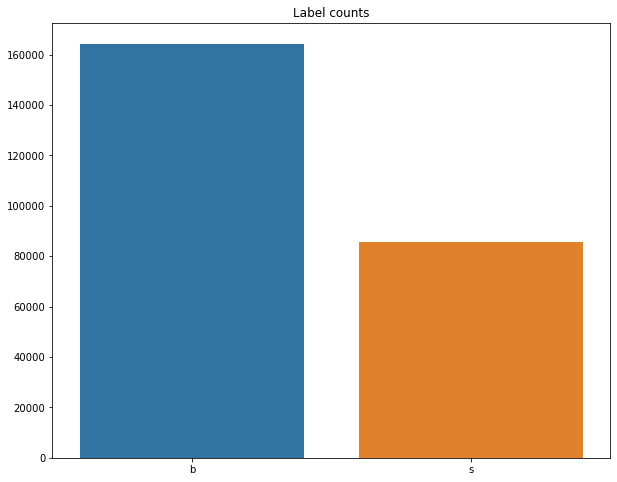

In [ ]:
fig,axes=plt.subplots(figsize=(10,8))
print(training['Label'].value_counts())
sns.barplot(x = training['Label'].value_counts().index, y = training['Label'].value_counts().values)
plt.title('Label counts')
plt.show()


*As we can see this is an unbalanced dataset, with more number of background events, characterised by 1 and less number of signal events characterised by 0*

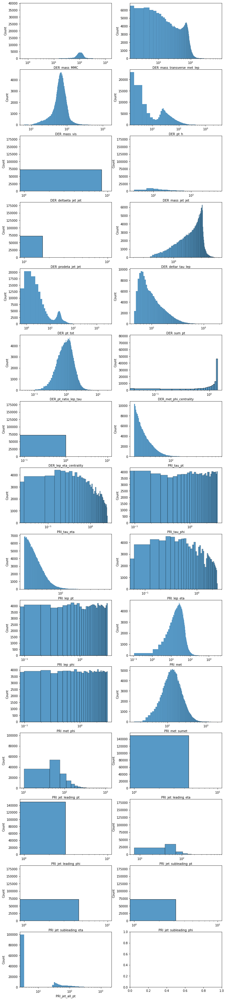

In [ ]:
#distribution of various features
ncols = 2
nrows = math.ceil(len(cont_vars)/ncols)
fig, axen = plt.subplots(nrows, ncols, figsize = (12, nrows*4))
for v, ax in zip(cont_vars, axen.ravel()):
    sns.histplot(train_dataX[v], ax=ax)
    ax.set_xscale('log')

In [ ]:
#viz = plot_corr_heatmap(train_dataX, figsize=(11,10))
#viz.save('corrheatmap.svg')
#viz

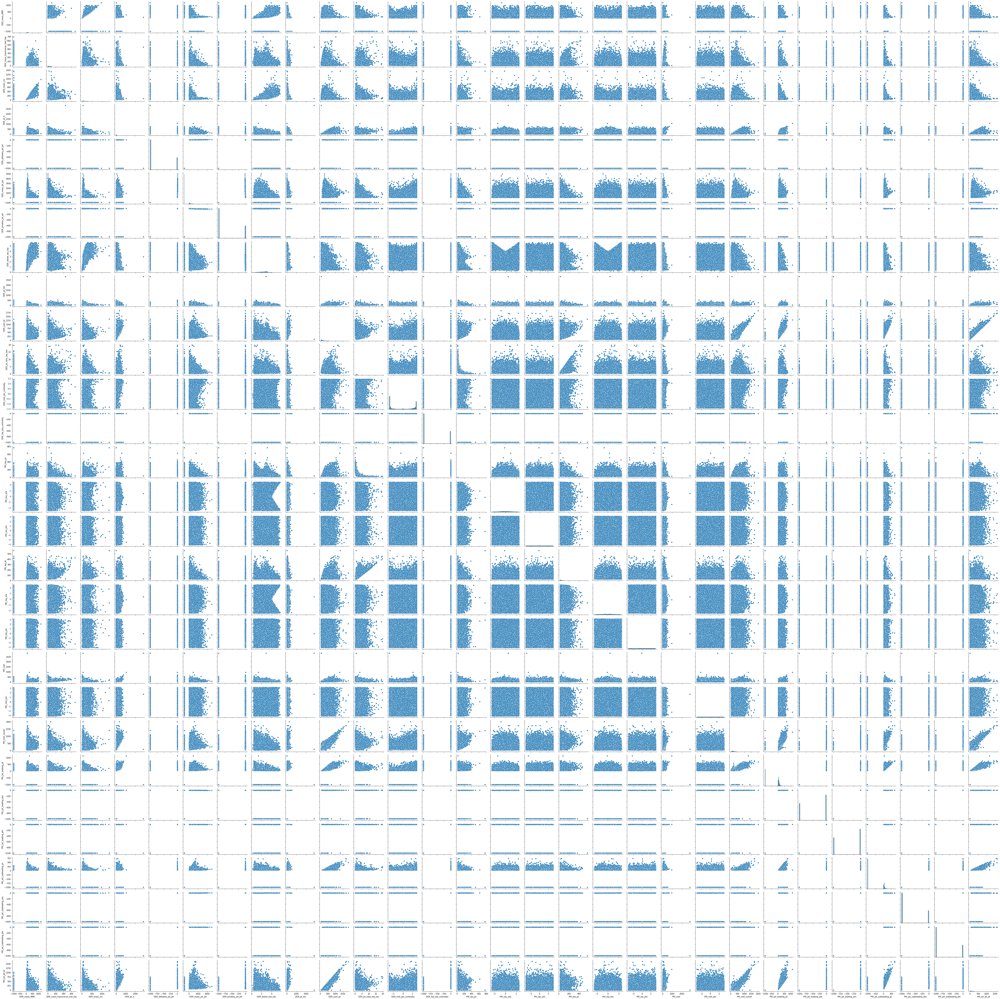

In [ ]:
sns.pairplot(data=train_dataX[cont_vars])

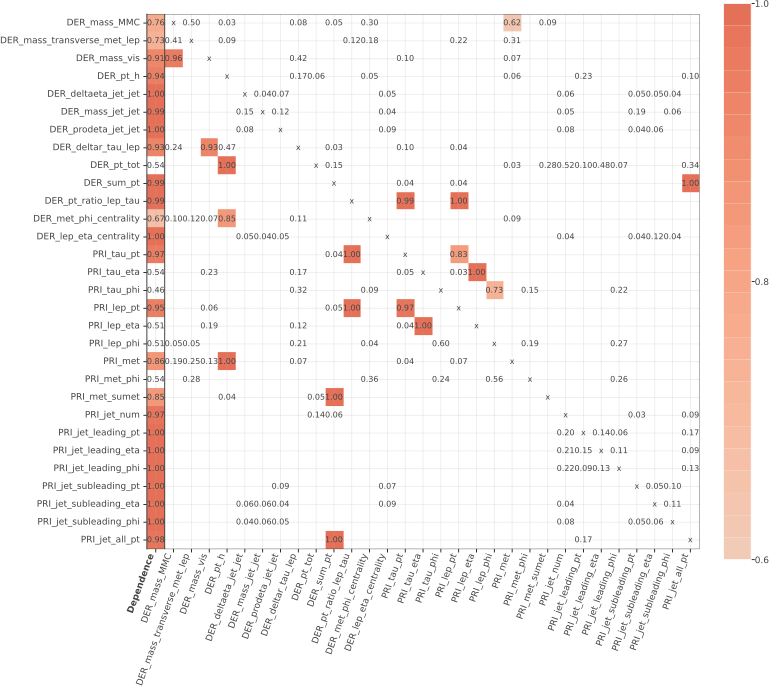

In [ ]:
D = feature_dependence_matrix(train_dataX)
viz = plot_dependence_heatmap(D, figsize=(11,10))
viz

*Here we have got hold of the multiple dependencies of the different variables. We will eliminate the collinearity of the variables while checking for the fearure importances post modelling.*

# Models:

#### Helper Function:

In [ ]:
def cv_optimize(clf, parameters, X, y, n_jobs=1, n_folds=5, score_func=None,oob_func=False):
    if ((not oob_func) and score_func):
        print("SCORE FUNC", score_func)
        gs = GridSearchCV(clf, param_grid=parameters, cv=n_folds, n_jobs=n_jobs, scoring=score_func)
    
    elif oob_func:
        print("OOB_Score")
        
        results = {}
        estimators= {}
        for n_est,mf,md in product(*parameters.values()):
            
            params = (n_est,mf,md)
            
            clf = RandomForestClassifier(random_state = 2017, n_estimators = n_est, max_features = mf, max_depth = md, oob_score=True, n_jobs = -1)
            
            clf.fit(X,y)
            
            results[params] = clf.oob_score_
            estimators[params] = clf
            
        outparams = max(results, key = results.get)
        
        print("Best Params: ",outparams)
        best_estimator = estimators[outparams]
        
        print("Training Score: ",best_estimator.score(X, y)) 
        print("OOB Score: ",best_estimator.oob_score_)
        
        return best_estimator

        
    else:
        gs = GridSearchCV(clf, param_grid=parameters, n_jobs=n_jobs, cv=n_folds)
        
    gs.fit(X, y)
    print("BEST", gs.best_params_, gs.best_score_)
    best = gs.best_estimator_
    return best

def do_classify(clf, parameters, indf,y,score_func, n_folds=5, n_jobs=1,oob_func=False):
    X=indf
    y=y
    Xtrain,Xtest,ytrain,ytest=train_test_split(X,y,train_size=0.8,random_state=2017)
    
    if oob_func:
        
        clf = cv_optimize(clf, parameters, Xtrain, ytrain, n_jobs=n_jobs, n_folds=n_folds, oob_func=True)
        
    else:
        clf = cv_optimize(clf, parameters, Xtrain, ytrain, n_jobs=n_jobs, n_folds=n_folds, score_func=score_func)
    
    
    training_accuracy = clf.score(Xtrain, ytrain)
    test_accuracy = clf.score(Xtest, ytest)
    
    print("############# based on standard predict ################")
    print("Accuracy on training data: %0.2f" % (training_accuracy))
    print("Accuracy on test data:     %0.2f" % (test_accuracy))
    
    print(confusion_matrix(ytest, clf.predict(Xtest)))
    
    print("########################################################")
    plot_confusion_matrix(clf,Xtest,ytest,cmap="Blues")
    return clf, Xtrain, ytrain, Xtest,ytest

In [ ]:
def make_roc(name, clf, ytest, xtest, ax=None, labe=5,  proba=True, skip=0, initial = False):
    if not ax:
        ax=plt.gca()
    if proba:
        fpr, tpr, thresholds=roc_curve(ytest, clf.predict_proba(xtest)[:,1])
    else:
        fpr, tpr, thresholds=roc_curve(ytest, clf.decision_function(xtest))
    roc_auc = auc(fpr, tpr)
    if skip:
        l=fpr.shape[0]
        ax.plot(fpr[0:l:skip], tpr[0:l:skip], '.-', lw=2, alpha=0.4, label='ROC curve for %s (area = %0.2f)' % (name, roc_auc))
    else:
        ax.plot(fpr, tpr, '.-', lw=2, alpha=0.4, label='ROC curve for %s (area = %0.2f)' % (name, roc_auc))
    label_kwargs = {}
    label_kwargs['bbox'] = dict(
        boxstyle='round,pad=0.3', alpha=0.2,
    )
    for k in range(0, fpr.shape[0],labe):
        #from https://gist.github.com/podshumok/c1d1c9394335d86255b8
        threshold = str(np.round(thresholds[k], 2))
        ax.annotate(threshold, (fpr[k], tpr[k]), **label_kwargs)
    if initial:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlim([0.0, 1.0])
        ax.set_ylim([0.0, 1.05])
        ax.set_xlabel('False Positive Rate')
        ax.set_ylabel('True Positive Rate')
        ax.set_title('ROC')
    ax.legend(loc="lower right")
    return ax

In [ ]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score

In [ ]:
def make_pr(name,clf,ytest,xtest,ax=None):
    
    scores = clf.predict_proba(xtest)[:,1]
    precision, recall, _ = precision_recall_curve(ytest, scores)
    
    ax.plot(recall,precision,'*-',label="Precision-Recall Curve for %s (area = %0.2f)" % (name,average_precision_score(ytest,scores)) )
    ax.set_xlim([-0.01,1.01])
    ax.set_ylim([-0.01,1.01])
    ax.set_xlabel('Recall', fontsize=12)
    ax.set_ylabel('Precision', fontsize=12)
    ax.grid()
    plt.tight_layout()
    plt.legend()
    return ax
    

In [ ]:
def calibration_plot(name,clf, xtest, ytest):

    fig, ax = plt.subplots(2,1,figsize=(8,15))

    #your code here
    fop, mpv = calibration_curve(ytest,clf.predict_proba(xtest)[:,1], n_bins=20)

    count = 0
    ax[0].plot(mpv, fop, marker='*',label="Calibration curve for %s" %(name))
    ax[0].plot([0,1],[0,1])

    ax[1].hist(clf.predict_proba(xtest)[:, 1], range=(0, 1), bins=20)

    rect=ax[1].patches


    # y_error = []
    # for r,i in enumerate(rect):
    #   # print(fop[r],i.get_height())

    #   y_error.append(math.sqrt( fop[r]*(1-fop[r]) / i.get_height() ))

    #   # print("Sigma = ",math.sqrt( fop[r]*(1-fop[r]) / i.get_height() ) )
    #   count+=i.get_height()

    
    # ax[0].errorbar(mpv, fop, yerr = y_error,marker = "o")

    fig.legend()

In [ ]:
def p_importance(model, cols, fi, fistd = 0):
    return pd.DataFrame({'features':cols, 'importance':fi, 'importance_std': fistd}
                       ).sort_values('importance', ascending=False)

In [ ]:
def plot_perm_importance(name,model,Xtest,ytest,last=False,number=10):
    
    imp = permutation_importance(model,Xtest,ytest)

    xgf_df=p_importance(imp,Xtest.columns,imp['importances_mean'],imp['importances_std'])

    fig,ax=plt.subplots(figsize=(17,10))
    
    if last:
        sns.barplot(data=xgf_df[-number:],x='features',y='importance',label='%s_importances'%(name),ax=ax)
        
    else:
        sns.barplot(data=xgf_df[:number],x='features',y='importance',label='%s_importances'%(name),ax=ax)
    
    plt.xticks(rotation='45')
    plt.title("Bar plot of Importances for %s"%(name));
    
    return xgf_df



### Baseline Model using LogisticRegression:

SCORE FUNC roc_auc
BEST {'model__C': 100} 0.8155375679897373
############# based on standard predict ################
Accuracy on training data: 0.75
Accuracy on test data:     0.75
[[ 9194  7905]
 [ 4506 28395]]
########################################################


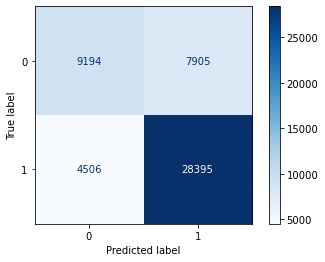

In [ ]:
# set up standardization
ss = StandardScaler()
# oe hot encoding
oh = OneHotEncoder()
# continuous variables need to be standardized
cont_pipe = Pipeline([("scale", ss)])
# categorical variables need to be one hot encoded
cat_pipe = Pipeline([('onehot', oh)])
# combine both into a transformer
transformers = [('cont', cont_pipe, cont_vars), ('cat', cat_pipe, cat_vars)]
# apply transformer to relevant columns. Nothing will be done for the rest
ct = ColumnTransformer(transformers=transformers, remainder="passthrough")
# create a pipeline so that we are not leaking data from validation to train in the individual folds
pipe = Pipeline(steps=[('ct', ct), ('model', LogisticRegression(max_iter=10000, penalty='l2'))])
# in paramgrid we dont use C but use model__C corresponding to the name in the pipeline
paramgrid = dict(model__C=[1000, 100, 10, 1, 0.1, 0.01, 0.001])

lr,Xtrain,ytrain,Xtest,ytest=do_classify(pipe, paramgrid,train_dataX, 
                              train_dataY, 
                              score_func='roc_auc')

In [ ]:
print(classification_report(ytest,lr.predict(Xtest)))

              precision    recall  f1-score   support

           0       0.67      0.54      0.60     17099
           1       0.78      0.86      0.82     32901

    accuracy                           0.75     50000
   macro avg       0.73      0.70      0.71     50000
weighted avg       0.74      0.75      0.74     50000



*The imbalance is causing the accuracy issue for predicting the the signal event. Hence, we will balance the dataset by upsampling and downsampling.*

In [ ]:
ytest.shape

(50000,)

<AxesSubplot:xlabel='Recall', ylabel='Precision'>

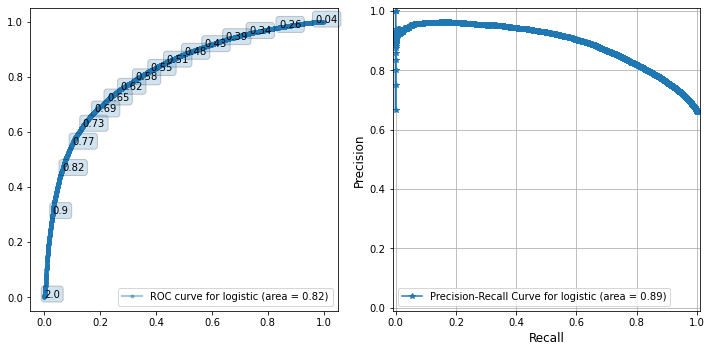

In [ ]:
fig,ax=plt.subplots(1,2,figsize=(10,5))

make_roc('logistic', lr,ytest ,Xtest, ax=ax[0],labe=1000, initial = False)
make_pr('logistic',lr,ytest,Xtest,ax=ax[1])


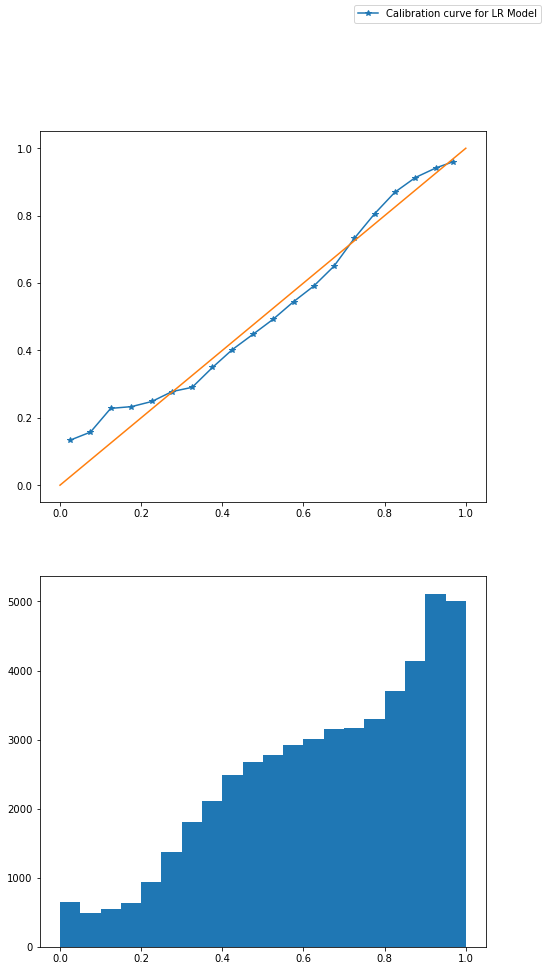

In [ ]:
 calibration_plot("LR Model",lr, Xtest, ytest)

### Upsampling and DownSampling:

In [ ]:
over = SMOTE(sampling_strategy='auto', k_neighbors=2)
under = RandomUnderSampler(sampling_strategy='auto')
steps = [('o', over), ('u', under)]
pipeline = imblearn.pipeline.Pipeline(steps=steps)
X, y = pipeline.fit_resample(train_dataX,train_dataY)
counter = collections.Counter(y)
print(counter)

Counter({0: 164333, 1: 164333})


### Baseline Model using Decision Tree Classifier:

SCORE FUNC roc_auc
BEST {'criterion': 'gini', 'max_depth': 8, 'min_samples_leaf': 4} 0.8818705806094034
############# based on standard predict ################
Accuracy on training data: 0.83
Accuracy on test data:     0.82
[[12220  4879]
 [ 4204 28697]]
########################################################


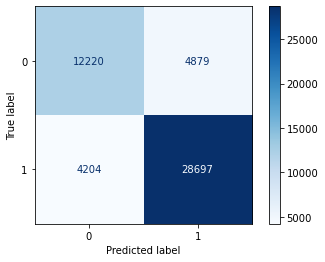

In [ ]:
clf=DecisionTreeClassifier(random_state=2017)
parameters={'max_depth':range(1,9),'min_samples_leaf':range(3,5),'criterion':['gini']}
clf, Xtrain, ytrain, Xtest,ytest=do_classify(clf, parameters,train_dataX,train_dataY,'roc_auc',n_folds=5,n_jobs=-1)

In [ ]:
print(classification_report(ytest,clf.predict(Xtest)))

              precision    recall  f1-score   support

           0       0.74      0.71      0.73     17099
           1       0.85      0.87      0.86     32901

    accuracy                           0.82     50000
   macro avg       0.80      0.79      0.80     50000
weighted avg       0.82      0.82      0.82     50000



In [ ]:
Xtrain.shape

(200000, 30)

SCORE FUNC roc_auc
BEST {'criterion': 'gini', 'max_depth': 8, 'min_samples_leaf': 4} 0.8818705806094034
############# based on standard predict ################
Accuracy on training data: 0.83
Accuracy on test data:     0.82
[[12220  4879]
 [ 4204 28697]]
########################################################


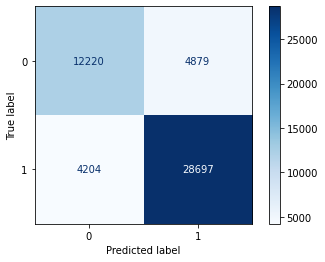

In [ ]:
clf=DecisionTreeClassifier(random_state=2017)
parameters={'criterion': ['gini'], 'max_depth': [8], 'min_samples_leaf': [4]}

clf, Xtrain, ytrain, Xtest,ytest=do_classify(clf, parameters,train_dataX,train_dataY,'roc_auc',n_folds=5,n_jobs=-1)


<AxesSubplot:xlabel='Recall', ylabel='Precision'>

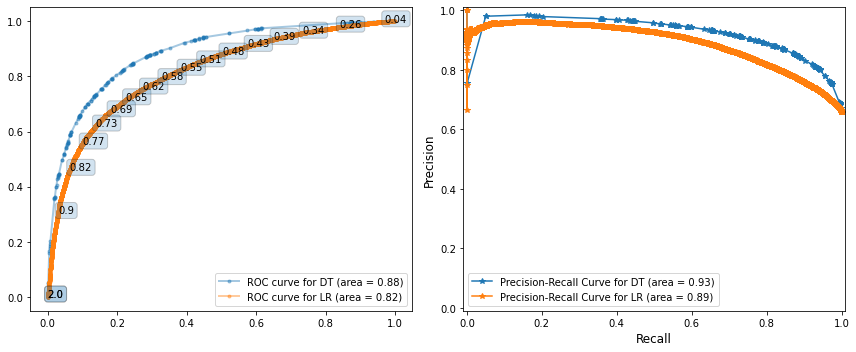

In [ ]:
fig,ax=plt.subplots(1,2,figsize=(12,5))

make_roc('DT', clf,ytest ,Xtest, ax=ax[0],labe=1000, initial = False)
make_roc('LR', lr,ytest ,Xtest, ax=ax[0],labe=1000, initial = False)

make_pr('DT',clf,ytest,Xtest,ax=ax[1])
make_pr('LR',lr,ytest,Xtest,ax=ax[1])



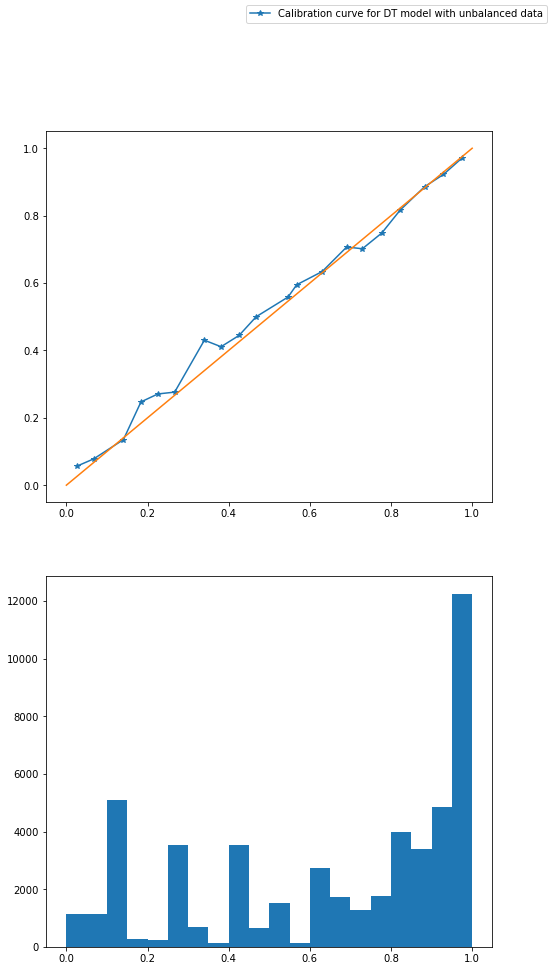

In [ ]:
calibration_plot("DT model with unbalanced data",clf,Xtest,ytest)

In [ ]:
colors = [None,  # 0 classes
          None,  # 1 class
          ['#FFF4E5','#D2E3EF'],# 2 classes
           ]
vizA = dtreeviz(clf, train_dataX,train_dataY,
               feature_names = train_dataX.columns,
               target_name = 'Label', class_names= ['No','Yes']
              ,orientation = 'TD',
               colors={'classes':colors},
               label_fontsize=14,
               ticks_fontsize=10,
               )
vizA

In [ ]:
vizA.save('tree.svg')

**Although the dataset is imbalanced,the decision tree seems to do a decent job wrt to handling the imbalance**

In [ ]:
def p_importance(model, cols, fi, fistd = 0):
    return pd.DataFrame({'features':cols, 'importance':fi, 'importance_std': fistd}
                       ).sort_values('importance', ascending=False)

,features,importance,importance_std
0,DER_mass_MMC,0.135864,0.001684
1,DER_mass_transverse_met_lep,0.049336,0.001917
2,DER_mass_vis,0.031748,0.000838
7,DER_deltar_tau_lep,0.014896,0.000651
13,PRI_tau_pt,0.013644,0.000499
11,DER_met_phi_centrality,0.008348,0.000413
3,DER_pt_h,0.006496,0.000271
19,PRI_met,0.005620,0.000382
4,DER_deltaeta_jet_jet,0.003724,0.000308
12,DER_lep_eta_centrality,0.002364,0.000339


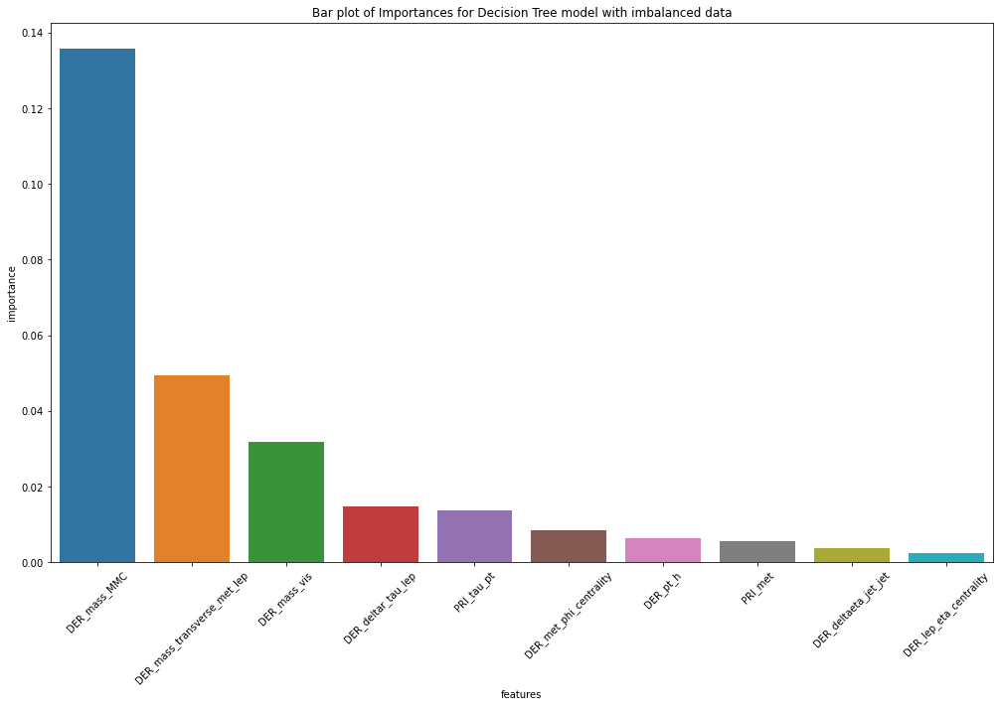

In [ ]:
plot_perm_importance("Decision Tree model with imbalanced data",clf,Xtest,ytest)

**we see in the dependences and importance plots, the most dependent variables are the least important amongst the top 10 as well.**

In [ ]:
##taking only those features which are important
features=['DER_mass_MMC','DER_mass_transverse_met_lep','DER_mass_vis','DER_deltar_tau_lep','PRI_tau_pt','DER_met_phi_centrality','DER_pt_h','PRI_met']

In [ ]:
features

['DER_mass_MMC',
 'DER_mass_transverse_met_lep',
 'DER_mass_vis',
 'DER_deltar_tau_lep',
 'PRI_tau_pt',
 'DER_met_phi_centrality',
 'DER_pt_h',
 'PRI_met']

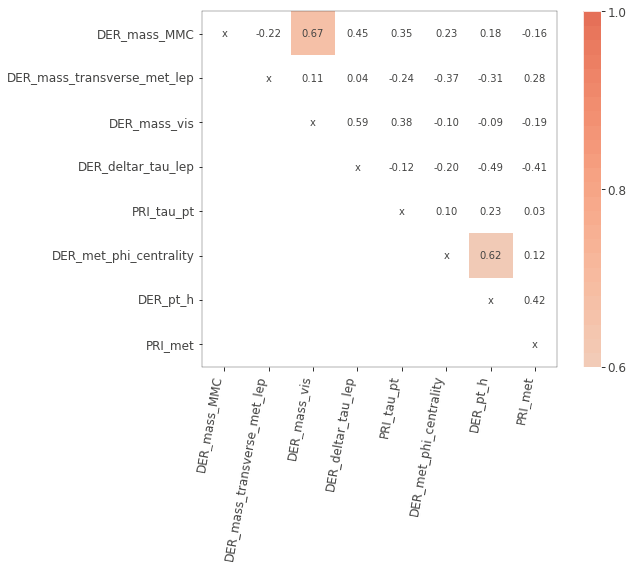

In [ ]:
from rfpimp import plot_corr_heatmap
viz = plot_corr_heatmap(Xtrain[features], figsize=(10,8),label_fontsize=12,value_fontsize=10)
viz.view()


SCORE FUNC roc_auc
BEST {'criterion': 'gini', 'max_depth': 8, 'min_samples_leaf': 3} 0.8867943728012468
############# based on standard predict ################
Accuracy on training data: 0.82
Accuracy on test data:     0.81
[[26651  6150]
 [ 6302 26631]]
########################################################


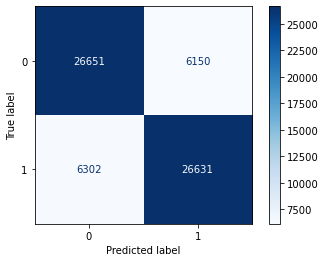

In [ ]:
clf_b=DecisionTreeClassifier(random_state=2017)
parameters={'max_depth':range(1,9),'min_samples_leaf':range(3,5),'criterion':['gini']}
clf_b, Xtrain_b, ytrain_b, Xtest_b,ytest_b=do_classify(clf, parameters,X,y,'roc_auc',n_folds=5,n_jobs=-1)

In [ ]:
print(classification_report(ytest_b,clf_b.predict(Xtest_b)))

              precision    recall  f1-score   support

           0       0.81      0.81      0.81     32801
           1       0.81      0.81      0.81     32933

    accuracy                           0.81     65734
   macro avg       0.81      0.81      0.81     65734
weighted avg       0.81      0.81      0.81     65734



SCORE FUNC roc_auc
BEST {'criterion': 'gini', 'max_depth': 8, 'min_samples_leaf': 4} 0.8875735186621128
############# based on standard predict ################
Accuracy on training data: 0.82
Accuracy on test data:     0.81
[[26774  6027]
 [ 6607 26326]]
########################################################


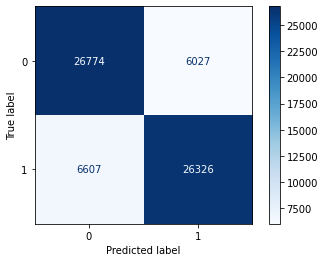

In [ ]:
clf_b=DecisionTreeClassifier(random_state=2017)
parameters={'criterion': ['gini'], 'max_depth': [8], 'min_samples_leaf': [4]}

clf_b, Xtrain_b, ytrain_b, Xtest_b,ytest_b=do_classify(clf_b, parameters,X,y,'roc_auc',n_folds=5,n_jobs=-1)


<AxesSubplot:xlabel='Recall', ylabel='Precision'>

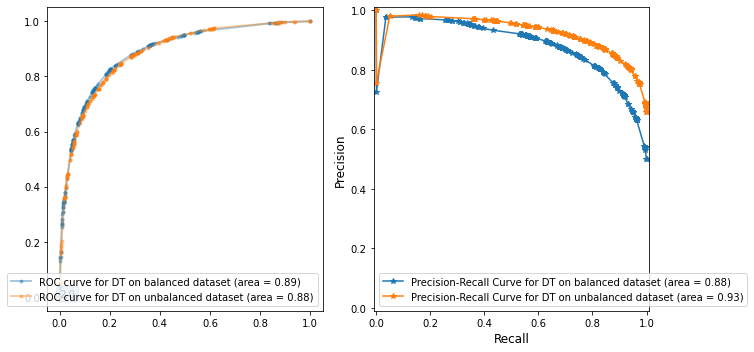

In [ ]:
fig,ax=plt.subplots(1,2,figsize=(10,5))

make_roc('DT on balanced dataset', clf_b,ytest_b ,Xtest_b, ax=ax[0],labe=1000, initial = False)
make_roc('DT on unbalanced dataset', clf,ytest ,Xtest, ax=ax[0],labe=1000, initial = False)


make_pr('DT on balanced dataset',clf_b,ytest_b,Xtest_b,ax=ax[1])
make_pr('DT on unbalanced dataset',clf,ytest,Xtest,ax=ax[1])

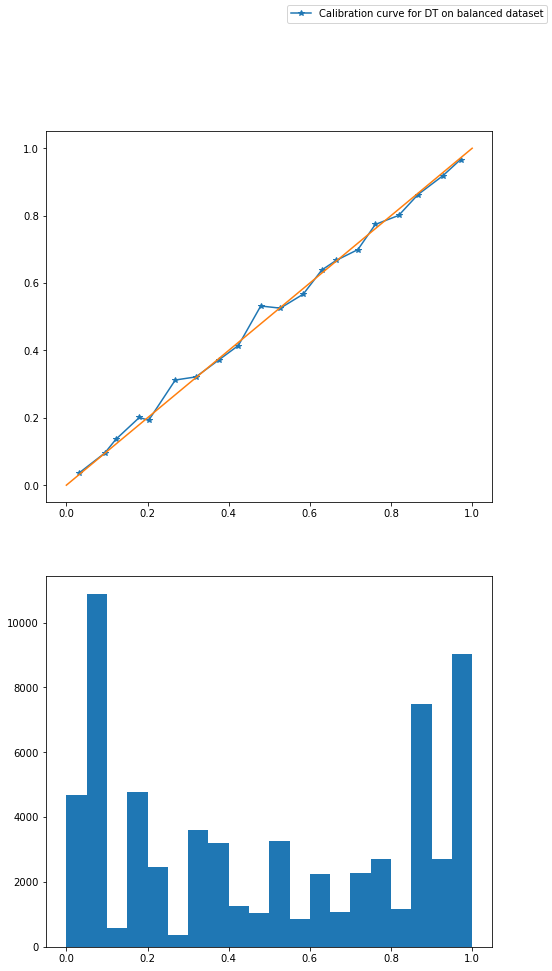

In [ ]:
calibration_plot("DT on balanced dataset",clf_b,Xtest_b,ytest_b)

In [ ]:
colors = [None,  # 0 classes
          None,  # 1 class
          ['#FFF4E5','#D2E3EF'],# 2 classes
           ]
vizb = dtreeviz(clf, Xtest,ytest,
               feature_names = Xtest.columns,
               target_name = 'Label', class_names= ['No','Yes']
              ,orientation = 'TD',
               colors={'classes':colors},
               label_fontsize=14,
               ticks_fontsize=10,
               )
vizb

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [ ]:
vizb.save('tree2.svg')

# Inferences So Far:
1. The dataset is highly imbalanced and hence imblearn functions are used for balancing the data.
2. 10 features are found on which the output strongly depends.
3. Distribution of different features show that most of them are continuous gausian distributions whereas some of them are Poisson in nature.
4. Baseline model of Logistic regression is implemented which has an ROC_AUC score 0f 0.81 for balanced data and 0.76 for imbalanced data.
5. Decision tree is implemented with cross validation and it gives an ROC_AUC score of 0.88 for imbalanced data and 0.89 for balanced data. 